# Create pendelum data, (time, theta1, theta2)

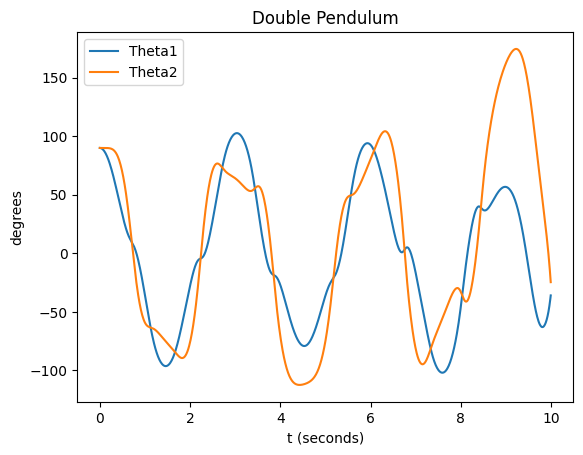

[[0.93816184 0.70528272]
 [0.93802455 0.70528272]
 [0.93761269 0.70528272]
 ...
 [0.29196326 0.34200083]
 [0.30672443 0.32439181]
 [0.32264658 0.30586965]]


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from math import sin, cos, pi
from numpy import array, arange, zeros_like
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import mean_squared_error, r2_score

g = 9.81
L1 = 1
L2 = 1
m1 = 1.0
m2 = 1.0

def f(r, t, L1, L2):
    theta1 = r[0]
    omega1 = r[1]
    theta2 = r[2]
    omega2 = r[3]

    ftheta1 = omega1
    fomega1 = (-g * (2 * m1 + m2) * sin(theta1) - m2 * g * sin(theta1 - 2 * theta2) - 2 * sin(theta1 - theta2) * m2 *
               (omega2**2 * L2 + omega1**2 * L1 * cos(theta1 - theta2))) / (L1 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    ftheta2 = omega2
    fomega2 = (2 * sin(theta1 - theta2) * (omega1**2 * L1 * (m1 + m2) + g * (m1 + m2) * cos(theta1) + omega2**2 * L2 * m2 *
                                           cos(theta1 - theta2))) / (L2 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    return array([ftheta1, fomega1, ftheta2, fomega2], float)

a = 0.0
b = 10
N = 1000
h = (b - a) / N

tpoints = np.arange(a, b, h) # seconds, split into intervals of 100
theta1_points = np.zeros_like(tpoints) # what the first pendulm angle should be (empty)
theta2_points = np.zeros_like(tpoints) # what the second pendulm angle should be (empty)

q = np.array([pi / 2, 0, pi / 2, 0], float)

for i, t in enumerate(tpoints):
    theta1_points[i] = q[0] * 180 / pi # converted from theta (θ) to degrees (°)
    theta2_points[i] = q[2] * 180 / pi

    k1 = h * f(q, t, L1, L2)
    k2 = h * f(q + 0.5 * k1, t + 0.5 * h, L1, L2)
    k3 = h * f(q + 0.5 * k2, t + 0.5 * h, L1, L2)
    k4 = h * f(q + k3, t + h, L1, L2)
    q += (k1 + 2 * k2 + 2 * k3 + k4) / 6

plt.plot(tpoints, theta1_points, label='Theta1') # what the first pendulm is (populated)
plt.plot(tpoints, theta2_points, label='Theta2') # what the second pendulm is (populated)
plt.title("Double Pendulum")
plt.xlabel("t (seconds)")
plt.ylabel("degrees")
plt.legend()
plt.show()

data = np.stack((theta1_points, theta2_points), axis=1)
np.save('pendulum_data.npy', data)

data = np.load('pendulum_data.npy')

scaler = MinMaxScaler()
data = scaler.fit_transform(data)

print(data)

# Turn data into inputs and outputs and setup model

In [ ]:
def create_io(data):
    xs, ys = [], []
    for i in range(len(data)):
        x = tpoints[i]
        y = data[i]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

X, y = create_io(data)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train = torch.tensor(X_train, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.float32)
X_test = torch.tensor(X_test, dtype=torch.float32)
y_test = torch.tensor(y_test, dtype=torch.float32)

train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=100, shuffle=True) # increased batch size makes training take less time
test_loader = DataLoader(test_dataset, batch_size=100, shuffle=False) # however it comes with the cost of not doing too well with new data

class StackedRNN(nn.Module): # keeping it stacked because im used to it
    def __init__(self, input_size, hidden_size, output_size):
        super(StackedRNN, self).__init__()
        #self.hidden_layer_size = hidden_layer_size
        self.rnn = nn.RNN(input_size, hidden_size=hidden_size, num_layers = 2, batch_first=True) # but only 2 layers to increase performace
        self.linear = nn.Linear(hidden_size, output_size)  # Multiply by 2 for bidirectional but were not doing that rn

    def forward(self, x):
        rnn_out_all, rnn_out_last = self.rnn(x)
        last_time_step = rnn_out_all[:, -1, :]
        y_pred = self.linear(last_time_step)
        return y_pred

# Train le data

In [ ]:
input_size = 3
hidden_size = 100
output_size = 2
srnn = StackedRNN(input_size, hidden_size, output_size)

# Access and adjust the weights and biases
for name, param in srnn.named_parameters():
    if 'weight' in name:
        nn.init.xavier_normal_(param)  # Xavier initialization
    elif 'bias' in name:
        nn.init.uniform_(param, -1, 1)  # were doing -1 1 init cause dr akl said it would be better

# Define the loss function and optimizer
loss_function = nn.MSELoss()
optimizer = optim.Adam(srnn.parameters(), lr=0.001)

early_stopping_patience = 10
best_loss = float('inf')
patience_counter = 0

def train_model(model, train_loader, test_loader, num_epochs): # trains the model with our train and test data
    global best_loss, patience_counter
    best_model = None

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for sequences, targets in train_loader:
            optimizer.zero_grad()
            y_pred = model(sequences)
            loss = loss_function(y_pred, targets)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        train_loss /= len(train_loader)

        model.eval()
        test_loss = 0
        with torch.no_grad():
            for sequences, targets in test_loader:
                y_pred = model(sequences)
                loss = loss_function(y_pred, targets)
                test_loss += loss.item()
        test_loss /= len(test_loader)

        print(f'Epoch {epoch+1}, Train Loss: {train_loss}, Test Loss: {test_loss}')

        if test_loss < best_loss:
            best_loss = test_loss
            best_model = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= early_stopping_patience:
            print("Early stopping")
            break

    if best_model:
        model.load_state_dict(best_model)

NUM_EPOCHS = 100                        # 100 epochs, standard
train_model(srnn, train_loader, test_loader, NUM_EPOCHS) # training!!!!

def evaluate_model(model, test_loader): # evaluates performace of our model in rmse and r^2
    model.eval()
    test_loss = 0
    all_preds = []
    all_targets = []
    with torch.no_grad():
        for sequences, targets in test_loader:
            y_pred = model(sequences)
            loss = torch.sqrt(loss_function(y_pred, targets))
            test_loss += loss.item()
            all_preds.append(y_pred)
            all_targets.append(targets)

    avg_test_loss = test_loss / len(test_loader)
    print(f'Test RMSE: {avg_test_loss}')

    all_preds = torch.cat(all_preds).numpy()
    all_targets = torch.cat(all_targets).numpy()

    r2 = r2_score(all_targets, all_preds)
    print(f'R^2 Score: {r2}')

evaluate_model(srnn, test_loader)

srnn.eval() # turn off training mode and go into output mode
with torch.no_grad():
    for sequences, targets in test_loader:
        y_pred = srnn(sequences)
        break

y_pred_original = scaler.inverse_transform(y_pred.numpy())
targets_original = scaler.inverse_transform(targets.numpy())

TypeError: StackedRNN.__init__() missing 1 required positional argument: 'num_layers'

# Plot predictions vs actual

IndexError: index 1 is out of bounds for axis 1 with size 1

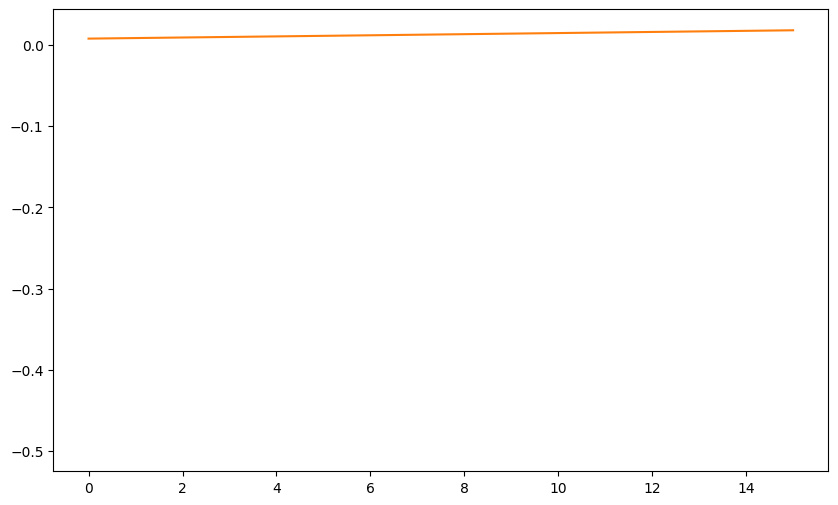

In [ ]:
# Ensure there are enough points to plot up to 100 timesteps
plot_range = max(100, len(y_pred_original), len(targets_original))

plt.figure(figsize=(10, 6))
plt.plot(y_pred_original[:plot_range, 0], label='Predicted Theta1')
plt.plot(targets_original[:plot_range, 0], label='Actual Theta1')
plt.plot(y_pred_original[:plot_range, 1], label='Predicted Theta2')
plt.plot(targets_original[:plot_range, 1], label='Actual Theta2')
plt.legend()
plt.xlim(0, 100)  # Extend x-axis to 100 time steps
plt.title('Predictions vs Actual')
plt.show()

# Animate results

#Testing

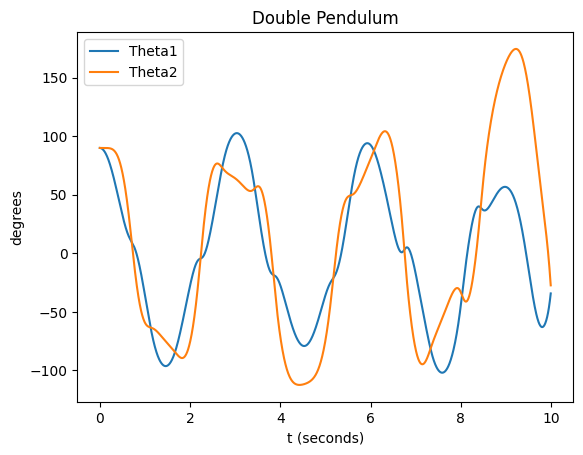

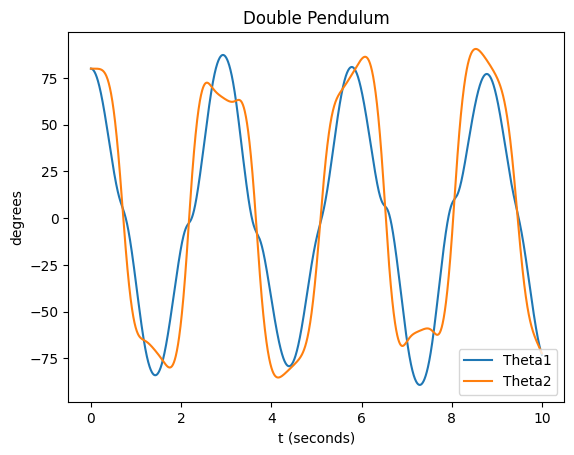

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from math import sin, cos, pi
from numpy import array, arange, zeros_like
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import mean_squared_error, r2_score

g = 9.81
L1 = 1
L2 = 1
m1 = 1.0
m2 = 1.0

def f(r, t, L1, L2):
    theta1 = r[0]
    omega1 = r[1]
    theta2 = r[2]
    omega2 = r[3]

    ftheta1 = omega1
    fomega1 = (-g * (2 * m1 + m2) * sin(theta1) - m2 * g * sin(theta1 - 2 * theta2) - 2 * sin(theta1 - theta2) * m2 *
               (omega2**2 * L2 + omega1**2 * L1 * cos(theta1 - theta2))) / (L1 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    ftheta2 = omega2
    fomega2 = (2 * sin(theta1 - theta2) * (omega1**2 * L1 * (m1 + m2) + g * (m1 + m2) * cos(theta1) + omega2**2 * L2 * m2 *
                                           cos(theta1 - theta2))) / (L2 * (2 * m1 + m2 - m2 * cos(2 * theta1 - 2 * theta2)))

    return array([ftheta1, fomega1, ftheta2, fomega2], float)

a = 0.0
b = 10
N = 2000
h = (b - a) / N

angles = [[90, 90],[80, 80]]

for x in angles:
  tpoints = np.arange(a, b, h) # seconds, split into intervals of 100
  theta1_points = np.zeros_like(tpoints) # what the first pendulm angle should be (empty)
  theta2_points = np.zeros_like(tpoints) # what the second pendulm angle should be (empty)

  q = np.array([x[0]*pi/180, 0, x[1]*pi/180, 0], float)

  for i, t in enumerate(tpoints):
      theta1_points[i] = q[0] * 180 / pi # converted from theta (θ) to degrees (°)
      theta2_points[i] = q[2] * 180 / pi

      k1 = h * f(q, t, L1, L2)
      k2 = h * f(q + 0.5 * k1, t + 0.5 * h, L1, L2)
      k3 = h * f(q + 0.5 * k2, t + 0.5 * h, L1, L2)
      k4 = h * f(q + k3, t + h, L1, L2)
      q += (k1 + 2 * k2 + 2 * k3 + k4) / 6

  plt.plot(tpoints, theta1_points, label='Theta1') # what the first pendulm is (populated)
  plt.plot(tpoints, theta2_points, label='Theta2') # what the second pendulm is (populated)
  plt.title("Double Pendulum")
  plt.xlabel("t (seconds)")
  plt.ylabel("degrees")
  plt.legend()
  plt.show()

  data = np.stack((theta1_points, theta2_points), axis=1)
  np.save(f'pendulum_data_{str(x[0])}_{str(x[1])}.npy', data)

{'90_90': array([[0.93815059, 0.70527607],
       [0.93811627, 0.70527607],
       [0.93801331, 0.70527607],
       ...,
       [0.31454543, 0.31523894],
       [0.3226367 , 0.30587611],
       [0.3309409 , 0.29635145]]), '80_80': array([[0.95859519, 0.94004365],
       [0.958556  , 0.94004365],
       [0.95843843, 0.94004365],
       ...,
       [0.09540769, 0.07708831],
       [0.09310051, 0.07555041],
       [0.09087   , 0.07401131]])}
Epoch 1, Train Loss: 0.1027847919263877, Test Loss: 0.09462868198752403, R^2 Score: 0.007930693940297162
Epoch 2, Train Loss: 0.09567762896185741, Test Loss: 0.09295449405908585, R^2 Score: 0.023782524493196622
Epoch 3, Train Loss: 0.09363287430023774, Test Loss: 0.09364948938600719, R^2 Score: 0.01578697070829088
Epoch 4, Train Loss: 0.09006035268539563, Test Loss: 0.0898401690647006, R^2 Score: 0.05451626508513224
Epoch 5, Train Loss: 0.08541028032777831, Test Loss: 0.08250965005718172, R^2 Score: 0.13063686980372496
Epoch 6, Train Loss: 0.083018246

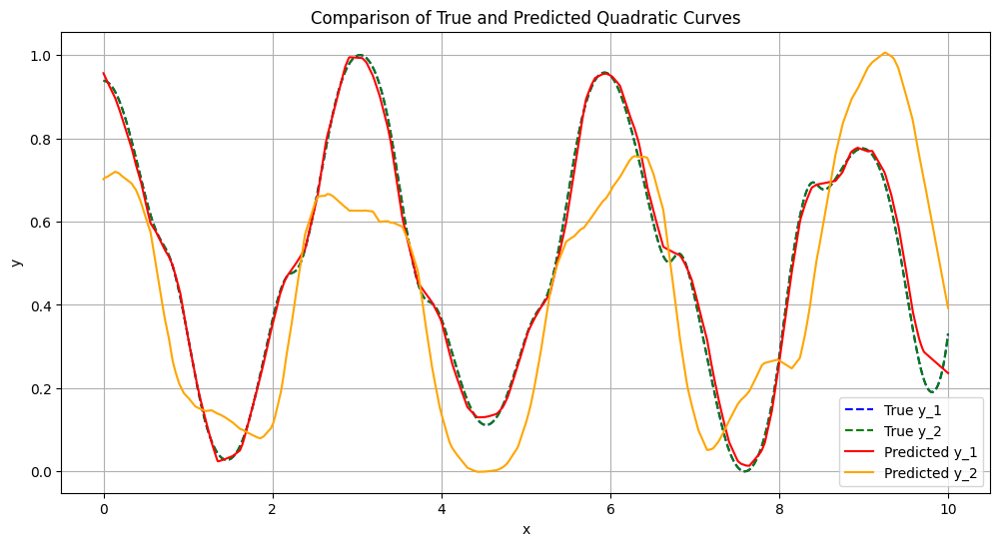

In [22]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader

# Define the dataset class
class QuadraticDataset(Dataset):
    def __init__(self, x, y):
        self.x = torch.tensor(x, dtype=torch.float32)  # Shape (N, 2)
        self.y = torch.tensor(y, dtype=torch.float32)  # Shape (N, 2)

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return self.x[idx], self.y[idx]

data = {}

for i in angles:
  loaded_data = np.load(f'pendulum_data_{str(i[0])}_{str(i[1])}.npy')
  scaler = MinMaxScaler()
  data_ = scaler.fit_transform(loaded_data)
  data[f'{str(i[0])}_{str(i[1])}'] = data_

print(data)


def create_io(data):
    x, x_1, x_2, y_1, y_2 = [], [], [], [], []
    # for i in angles
    for starting in data:
      starting_theta_1_degrees = int(starting.split("_")[0])
      starting_theta_2_degrees = int(starting.split("_")[1])

      starting_theta_1 = starting_theta_1_degrees * pi /180
      starting_theta_2 = starting_theta_2_degrees * pi /180

      angle_data = data[starting]
      for i in range(len(angle_data)):
          x.append(tpoints[i])
          x_1.append(starting_theta_1)
          x_2.append(starting_theta_2)
          y_1.append(angle_data[i][0])
          y_2.append(angle_data[i][1])
    return x, x_1, x_2, y_1, y_2

x, x_1, x_2, y_1, y_2 = create_io(data)

# Normalize data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

# Combine x_1 and x_2 into one feature matrix
x_combined = np.vstack([x_1, x_2, x]).T
x_scaled = scaler_x.fit_transform(x_combined)

# Combine y_1 and y_2 into one target matrix
y_combined = np.vstack([y_1, y_2]).T
y_scaled = scaler_y.fit_transform(y_combined)

# Create dataset and dataloaders
dataset = QuadraticDataset(x_scaled, y_scaled)
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size
train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=10, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=10, shuffle=False)

# Define the model class
class ImprovedStackedRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers):
        super(ImprovedStackedRNN, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True, nonlinearity='relu')
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # x should be (batch_size, sequence_length, input_size)
        out, _ = self.rnn(x)
        # out should be (batch_size, sequence_length, hidden_size)
        out = self.fc(out[:, -1, :])  # Output from the final time step
        return out

# Create a new model instance
input_size = 3  # Two input features
hidden_size = 100
output_size = 2  # Two output values
num_layers = 5
srnn = ImprovedStackedRNN(input_size, hidden_size, output_size, num_layers)

# Define loss function and optimizer
loss_function = nn.MSELoss()
optimizer = optim.Adam(srnn.parameters(), lr=0.001)

early_stopping_patience = 10
best_loss = float('inf')
patience_counter = 0

# Training function with early stopping
def train_model(model, train_loader, test_loader, num_epochs):
    best_loss = float('inf')
    patience_counter = 0
    best_model = None

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for sequences, targets in train_loader:
            sequences = sequences.unsqueeze(1)  # Add sequence dimension
            targets = targets  # Target should be (batch_size, output_size)
            optimizer.zero_grad()
            y_pred = model(sequences)
            loss = loss_function(y_pred, targets)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        train_loss /= len(train_loader)

        model.eval()
        test_loss = 0
        all_preds = []
        all_targets = []
        with torch.no_grad():
            for sequences, targets in test_loader:
                sequences = sequences.unsqueeze(1)  # Add sequence dimension
                targets = targets
                y_pred = model(sequences)
                loss = loss_function(y_pred, targets)
                test_loss += loss.item()
                all_preds.append(y_pred)
                all_targets.append(targets)

        test_loss /= len(test_loader)

        # Flatten the lists and convert to numpy arrays
        all_preds = torch.cat(all_preds).numpy()
        all_targets = torch.cat(all_targets).numpy()

        r2 = r2_score(all_targets, all_preds, multioutput='uniform_average')
        print(f'Epoch {epoch+1}, Train Loss: {train_loss}, Test Loss: {test_loss}, R^2 Score: {r2}')

        if test_loss < best_loss:
            best_loss = test_loss
            best_model = model.state_dict()
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= early_stopping_patience:
            print("Early stopping")
            break

    if best_model:
        model.load_state_dict(best_model)

NUM_EPOCHS = 100
train_model(srnn, train_loader, test_loader, NUM_EPOCHS)

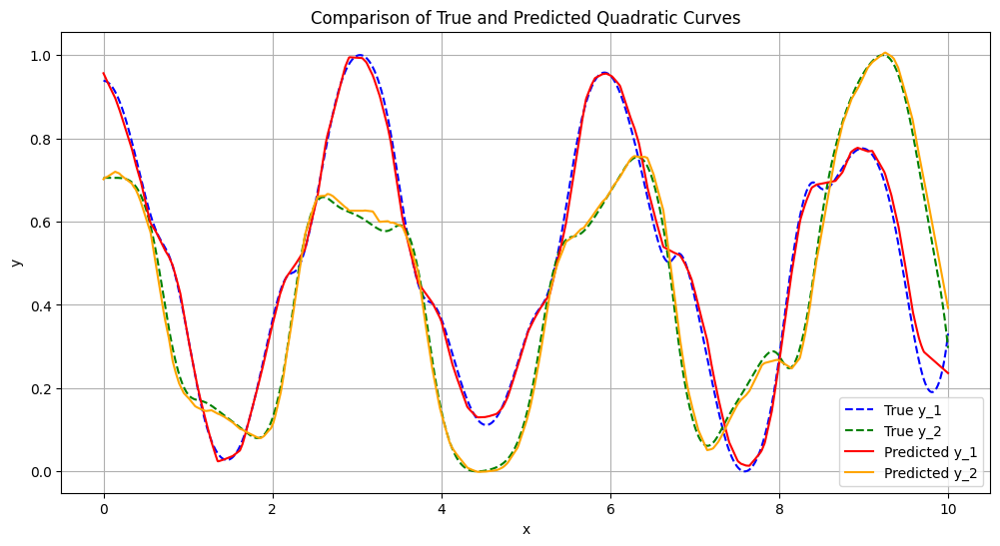

In [31]:
# Generate predictions for 90, 90
x_1_90_90 = x_1[:2000]
x_2_90_90 = x_2[:2000]
x_90_90 = x[:2000]
y_1_90_90 = y_1[:2000]
y_2_90_90 = y_2[:2000]

x_dense_combined = np.vstack([x_1_90_90, x_2_90_90, x_90_90]).T
x_dense_scaled = scaler_x.transform(x_dense_combined)
x_dense_tensor = torch.tensor(x_dense_scaled, dtype=torch.float32).unsqueeze(1)  # Shape (500, 1, 2)

srnn.eval()
with torch.no_grad():
    y_pred_scaled = srnn(x_dense_tensor).numpy()

# Inverse transform predictions
y_pred_90_90 = scaler_y.inverse_transform(y_pred_scaled)

# PLOTTING LOOKS A LITTLE OFF BECAUSE IT IS PLOTTING ALL ANGLES, NEEDS TO BE TURNED INTO NUMPY ARRAY AND SET TO NP.WHERE
# x_1 = initial angle 1 and x_2 is initial angle

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(x_90_90, y_1_90_90, label='True y_1', color='blue', linestyle='--')
plt.plot(x_90_90, y_2_90_90, label='True y_2', color='green', linestyle='--')
plt.plot(x_90_90, y_pred_90_90[:, 0], label='Predicted y_1', color='red')
plt.plot(x_90_90, y_pred_90_90[:, 1], label='Predicted y_2', color='orange')
plt.xlabel('x')
plt.ylabel('y')
plt.title('Comparison of True and Predicted Quadratic Curves')
plt.legend()
plt.grid(True)
plt.show()

# For testing specific angles

In [7]:
# for testing specific angles

srnn.eval()
with torch.no_grad():
    y_pred_scaled = srnn(torch.tensor(scaler_x.transform(np.vstack([pi/2, pi/2, 4]).T), dtype=torch.float32).unsqueeze(1)).numpy()

# Inverse transform predictions
y_prediction_test = scaler_y.inverse_transform(y_pred_scaled)
print(y_prediction_test)

# Animation

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from math import sin, cos, pi

from matplotlib import rc
rc('animation', html='jshtml')

def theta_to_xy(theta1, theta2, theta1Len=1, theta2len=1):
    convert = pi/180
    x1 = sin(theta1*convert) * theta1Len
    y1 = -cos(theta1*convert) * theta1Len
    x2 = x1 + sin(theta2*convert) * theta2len
    y2 = y1 - cos(theta2*convert) * theta2len
    return [x1, y1, x2, y2]

x1_points = []
y1_points = []
x2_points = []
y2_points = []

x1_points_p = []
y1_points_p = []
x2_points_p = []
y2_points_p = []

for i in range(len(tpoints)):
    preddy = scaler.inverse_transform(y_pred_90_90)
    actual = scaler.inverse_transform(data["90_90"])

    x1, y1, x2, y2 = theta_to_xy(actual[i][0], actual[i][1])
    x1_points.append(x1)
    y1_points.append(y1)
    x2_points.append(x2)
    y2_points.append(y2)

    t1 = preddy[i][0]
    t2 = preddy[i][1]

    x1p, y1p, x2p, y2p = theta_to_xy(t1, t2)
    x1_points_p.append(x1p)
    y1_points_p.append(y1p)
    x2_points_p.append(x2p)
    y2_points_p.append(y2p)


fig = plt.figure(figsize=(5, 4))
L = 2
ax = fig.add_subplot(autoscale_on=False, xlim=(-L, L), ylim=(-L, L))
ax.set_aspect('equal')
ax.grid()

line, = ax.plot([], [], 'o-', lw=2)
trace, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
line_p, = ax.plot([], [], 'o-', lw=2)
trace_p, = ax.plot([], [], 'r-', lw=1, ms=2, alpha=0.5)
time_template = 'time = %.1fs'
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    trace.set_data([], [])
    line_p.set_data([], [])
    trace_p.set_data([], [])
    time_text.set_text('')
    return line, trace, line_p, trace_p, time_text

def update(i):
    thisx = [0, x1_points[i], x2_points[i]]
    thisy = [0, y1_points[i], y2_points[i]]

    history_x = x2_points[:i]
    history_y = y2_points[:i]

    thisx_p = [0, x1_points_p[i], x2_points_p[i]]
    thisy_p = [0, y1_points_p[i], y2_points_p[i]]

    history_x_p = x2_points_p[:i]
    history_y_p = y2_points_p[:i]

    line.set_data(thisx, thisy)
    trace.set_data(history_x, history_y)
    line_p.set_data(thisx_p, thisy_p)
    trace_p.set_data(history_x_p, history_y_p)
    time_text.set_text(time_template % (i * h))
    return line, trace, line_p, trace_p, time_text

ani = FuncAnimation(fig, update, frames=len(tpoints), init_func=init, blit=True, interval=20)
print(len(tpoints))
print(tpoints)
plt.close()
ani

2000
[0.000e+00 5.000e-03 1.000e-02 ... 9.985e+00 9.990e+00 9.995e+00]
